# Medical Appointment Analysis

In this notebook we will try to analyze why would some patient not show up for his medical appointment and whether there are reasons for that using the data we have.
We will try to find some correlation between the different attributes we have and whether the patient shows up or not. The dataset we are going to use contains 110.527 medical appointments and its 14 associated variables ( PatientId, AppointmentID, Gender, ScheduledDay, AppointmentDay, Age, Neighbourhood, Scholarship, Hypertension, Diabetes, Alcoholism, Handcap', SMS_received, No-show )

### Dataset Description
A person makes a doctor appointment, receives all the instructions and no-show. Who to blame? This dataset collects information from 100k medical appointments in Brazil and is focused on the question of whether or not patients show up for their appointment. A number of characteristics about the patient are included in each row.


### Data Dictionary
- **PatientId**
    Identification of a patient
- **AppointmentID**
    Identification of each appointment
- **Gender**
Male or Female . Female is the greater proportion, woman takes way more care of they health in comparison to man.
- **AppointmentDate**
The day of the actuall appointment, when they have to visit the doctor.
- **ScheduledDate**
The day someone called or registered the appointment, this is before appointment of course.
- **Age**
How old is the patient.
- **Neighbourhood**
Where the appointment takes place.
- **Scholarship**
True of False
- **Hipertension**
True or False
- **Diabetes**
True or False
- **Alcoholism**
True or False
- **Handcap**
True or False
- **SMS_received**
1 or more messages sent to the patient.
- **No-show**
True or False.

### EDA Questions

Q1: How often do men go to hospitals compared to women? Which of them is more likely to show up?

Q2: Does recieving an SMS as a reminder affect whether or not a patient may show up? is it correlated with number of days before the appointment?

Q3: Does having a scholarship affects showing up on a hospital appointment? What are the age groups affected by this?

Q4: Does having certain deseases affect whather or not a patient may show up to their appointment? is it affected by gender?


## Setup

In [ ]:
#!pip install seaborn

In [ ]:
#!pip install scikit-learn

In [12]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import plotly.express as px
#choose plots style
sns.set_style('darkgrid')
#make sure plots are inline with the notebook
%matplotlib inline
from plotly.subplots import make_subplots
import plotly.graph_objects as go

In [13]:
import warnings
warnings.filterwarnings('ignore')

# Defined functions

In [14]:
def add_assistance_percentage_per_indicator(df, indicator):
    # Define column name
    col_name = "Total "+indicator+" appointments"

    # Add a column for the total appointmens per indicator class to get the percentage
    df[col_name] = df[indicator].map(dict(df.groupby([indicator])["Assistance"].sum()))

    # Add a column representing the percentage of assistance to the apointment
    df["Percentage of appointments"] = (df["Assistance"] * 100 ) / df[col_name].astype(float)

    return df

In [15]:
def plot_missing_assistance_percentage_per_indicator(df, indicator, title):

    # Plot appointments missing rate by scholarship class
    days = ["Monday","Tuesday","Wednesday","Thursday","Friday","Saturday","Sunday"]

    fig = px.bar(df[df["Assisted"] == False ],
                title =title,
                color=indicator, y="Percentage of appointments", x=indicator,
                labels = {
                    "Percentage of appointments" : "Percentage of missed appointments (%)"
                },
                category_orders={
                    indicator: days
                },
                text_auto=".4s")

    # Set values over the bars
    fig.update_traces(textfont_size=12, textangle=0, textposition="outside", cliponaxis=False)

    # Hide legend
    fig.update_layout(showlegend=False)

    fig.show()

In [16]:
import seaborn as sns

def plot_confusion_matrix(cm, title="Confusion Matrix"):
    plt.figure(figsize=(6,6))
    sns.set(font_scale=1.5)
    ax = sns.heatmap(cm, annot=True, annot_kws={"size":16}, fmt='g', cmap='Blues', cbar=False)

    ax.set_xlabel("Predicted values")
    ax.xaxis.set_ticklabels(['Negative','Positive'])

    ax.set_ylabel("Actual values")
    ax.yaxis.set_ticklabels(['Negative','Positive'])

    ax.set_title(title)

In [17]:
from sklearn.metrics import roc_curve, auc

def plot_roc_curve(x_test, y_test, model):

    y_score = model.predict_proba(x_test)[:, 1]

    fpr, tpr, thresholds = roc_curve(y_test, y_score)

    fig = px.area(
        x=fpr, y=tpr,
        title=f'ROC Curve (AUC={auc(fpr, tpr):.4f})',
        labels=dict(x='False Positive Rate', y='True Positive Rate'),
        width=700, height=500
    )

    fig.add_shape(
        type='line', line=dict(dash='dash'),
        x0=0, x1=1, y0=0, y1=1
    )

    fig.update_yaxes(scaleanchor="x", scaleratio=1)
    fig.update_xaxes(constrain='domain')
    fig.show()

# Dataset Overview

### Loading the dataset and checking the columns we have


In [19]:
df = pd.read_csv('./data/KaggleV2-May-2016.csv')
df.head()

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show
0,2.987250e+13,5642903,F,2016-04-29T18:38:08Z,2016-04-29T00:00:00Z,62,JARDIM DA PENHA,0,1,0,0,0,0,No
1,5.589978e+14,5642503,M,2016-04-29T16:08:27Z,2016-04-29T00:00:00Z,56,JARDIM DA PENHA,0,0,0,0,0,0,No
2,4.262962e+12,5642549,F,2016-04-29T16:19:04Z,2016-04-29T00:00:00Z,62,MATA DA PRAIA,0,0,0,0,0,0,No
3,8.679512e+11,5642828,F,2016-04-29T17:29:31Z,2016-04-29T00:00:00Z,8,PONTAL DE CAMBURI,0,0,0,0,0,0,No
4,8.841186e+12,5642494,F,2016-04-29T16:07:23Z,2016-04-29T00:00:00Z,56,JARDIM DA PENHA,0,1,1,0,0,0,No


In [20]:
# Get the shape and types of our data
print(df.shape)
pd.DataFrame(df.dtypes)

(110527, 14)


,0
PatientId,float64
AppointmentID,int64
Gender,object
ScheduledDay,object
AppointmentDay,object
Age,int64
Neighbourhood,object
Scholarship,int64
Hipertension,int64
Diabetes,int64


In [21]:
# Get some statistics about our data
df.describe()

,PatientId,AppointmentID,Age,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received
count,1.105270e+05,1.105270e+05,110527.000000,110527.000000,110527.000000,110527.000000,110527.000000,110527.000000,110527.000000
mean,1.474963e+14,5.675305e+06,37.088874,0.098266,0.197246,0.071865,0.030400,0.022248,0.321026
std,2.560949e+14,7.129575e+04,23.110205,0.297675,0.397921,0.258265,0.171686,0.161543,0.466873
min,3.921784e+04,5.030230e+06,-1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,4.172614e+12,5.640286e+06,18.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,3.173184e+13,5.680573e+06,37.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,9.439172e+13,5.725524e+06,55.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
max,9.999816e+14,5.790484e+06,115.000000,1.000000,1.000000,1.000000,1.000000,4.000000,1.000000


In [22]:
# Show data basic info
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 110527 entries, 0 to 110526
Data columns (total 14 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   PatientId       110527 non-null  float64
 1   AppointmentID   110527 non-null  int64  
 2   Gender          110527 non-null  object 
 3   ScheduledDay    110527 non-null  object 
 4   AppointmentDay  110527 non-null  object 
 5   Age             110527 non-null  int64  
 6   Neighbourhood   110527 non-null  object 
 7   Scholarship     110527 non-null  int64  
 8   Hipertension    110527 non-null  int64  
 9   Diabetes        110527 non-null  int64  
 10  Alcoholism      110527 non-null  int64  
 11  Handcap         110527 non-null  int64  
 12  SMS_received    110527 non-null  int64  
 13  No-show         110527 non-null  object 
dtypes: float64(1), int64(8), object(5)
memory usage: 11.8+ MB


In [23]:
# Check for missing values in our data
df.isna().any()

PatientId         False
AppointmentID     False
Gender            False
ScheduledDay      False
AppointmentDay    False
Age               False
Neighbourhood     False
Scholarship       False
Hipertension      False
Diabetes          False
Alcoholism        False
Handcap           False
SMS_received      False
No-show           False
dtype: bool

In [24]:
# Check for duplicated rows in our data
df.duplicated().any()

False

Data doesn't have any duplicated or missing values.

However, we can see that in our "Age" variable the min age value is -1.

In [25]:
df[(df["Age"] == -1)]

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show
99832,4.659432e+14,5775010,F,2016-06-06T08:58:13Z,2016-06-06T00:00:00Z,-1,ROMÃO,0,0,0,0,0,0,No


In [26]:
# Drop corrupted value
df.drop(df[(df["Age"] == -1)].index, axis=0, inplace=True)

In [27]:
df.describe()

,PatientId,AppointmentID,Age,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received
count,1.105260e+05,1.105260e+05,110526.000000,110526.000000,110526.000000,110526.000000,110526.000000,110526.000000,110526.000000
mean,1.474934e+14,5.675304e+06,37.089219,0.098266,0.197248,0.071865,0.030400,0.022248,0.321029
std,2.560943e+14,7.129544e+04,23.110026,0.297676,0.397923,0.258266,0.171686,0.161543,0.466874
min,3.921784e+04,5.030230e+06,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,4.172536e+12,5.640285e+06,18.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,3.173184e+13,5.680572e+06,37.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,9.438963e+13,5.725523e+06,55.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
max,9.999816e+14,5.790484e+06,115.000000,1.000000,1.000000,1.000000,1.000000,4.000000,1.000000


# Data cleaning

As we have seen, our data has no missing or duplicated values. However some modifications may be done to make it more exploitable such as :

* Drop non necessary columns
* Rename some columns and
* Correct data types and values

Let's start by dropping the columns in our dataframe that wi'll not be usefull for us such as the PatientId and the AppointmentID columns.

In [28]:
# Drop irrelevant columns
df.drop(['PatientId','AppointmentID'],axis=1,inplace=True)
df.head()

,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show
0,F,2016-04-29T18:38:08Z,2016-04-29T00:00:00Z,62,JARDIM DA PENHA,0,1,0,0,0,0,No
1,M,2016-04-29T16:08:27Z,2016-04-29T00:00:00Z,56,JARDIM DA PENHA,0,0,0,0,0,0,No
2,F,2016-04-29T16:19:04Z,2016-04-29T00:00:00Z,62,MATA DA PRAIA,0,0,0,0,0,0,No
3,F,2016-04-29T17:29:31Z,2016-04-29T00:00:00Z,8,PONTAL DE CAMBURI,0,0,0,0,0,0,No
4,F,2016-04-29T16:07:23Z,2016-04-29T00:00:00Z,56,JARDIM DA PENHA,0,1,1,0,0,0,No


Now let's rename the "No show" column and change the values to a boolean version

In [29]:
# Rename column
df.rename(columns={"No-show": "Assisted"}, inplace=True)

# Change values in the column
df["Assisted"].replace("No", True, inplace=True)
df["Assisted"].replace("Yes", False, inplace=True)

df.head()

,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,Assisted
0,F,2016-04-29T18:38:08Z,2016-04-29T00:00:00Z,62,JARDIM DA PENHA,0,1,0,0,0,0,True
1,M,2016-04-29T16:08:27Z,2016-04-29T00:00:00Z,56,JARDIM DA PENHA,0,0,0,0,0,0,True
2,F,2016-04-29T16:19:04Z,2016-04-29T00:00:00Z,62,MATA DA PRAIA,0,0,0,0,0,0,True
3,F,2016-04-29T17:29:31Z,2016-04-29T00:00:00Z,8,PONTAL DE CAMBURI,0,0,0,0,0,0,True
4,F,2016-04-29T16:07:23Z,2016-04-29T00:00:00Z,56,JARDIM DA PENHA,0,1,1,0,0,0,True


In [30]:
df.dtypes

Gender            object
ScheduledDay      object
AppointmentDay    object
Age                int64
Neighbourhood     object
Scholarship        int64
Hipertension       int64
Diabetes           int64
Alcoholism         int64
Handcap            int64
SMS_received       int64
Assisted            bool
dtype: object

We can see that "ScheduledDay" and "AppointmentDay" columns are object type. In this cases we can change the data type to date.

In [31]:
# Change data columns to date type
df['ScheduledDay']=pd.to_datetime(df['ScheduledDay'])
df['AppointmentDay']=pd.to_datetime(df['AppointmentDay'])
df.rename(columns={"ScheduledDay":"ScheduledDate", "AppointmentDay":"AppointmentDate"}, inplace=True)

In [32]:
# Add columns for date day
import datetime
df["AppointmentDay"] = df["AppointmentDate"].dt.strftime("%A")
df["ScheduledDay"] = df["ScheduledDate"].dt.strftime("%A")
df.head(10)

,Gender,ScheduledDate,AppointmentDate,Age,Neighbourhood,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,Assisted,AppointmentDay,ScheduledDay
0,F,2016-04-29 18:38:08+00:00,2016-04-29 00:00:00+00:00,62,JARDIM DA PENHA,0,1,0,0,0,0,True,Friday,Friday
1,M,2016-04-29 16:08:27+00:00,2016-04-29 00:00:00+00:00,56,JARDIM DA PENHA,0,0,0,0,0,0,True,Friday,Friday
2,F,2016-04-29 16:19:04+00:00,2016-04-29 00:00:00+00:00,62,MATA DA PRAIA,0,0,0,0,0,0,True,Friday,Friday
3,F,2016-04-29 17:29:31+00:00,2016-04-29 00:00:00+00:00,8,PONTAL DE CAMBURI,0,0,0,0,0,0,True,Friday,Friday
4,F,2016-04-29 16:07:23+00:00,2016-04-29 00:00:00+00:00,56,JARDIM DA PENHA,0,1,1,0,0,0,True,Friday,Friday
5,F,2016-04-27 08:36:51+00:00,2016-04-29 00:00:00+00:00,76,REPÚBLICA,0,1,0,0,0,0,True,Friday,Wednesday
6,F,2016-04-27 15:05:12+00:00,2016-04-29 00:00:00+00:00,23,GOIABEIRAS,0,0,0,0,0,0,False,Friday,Wednesday
7,F,2016-04-27 15:39:58+00:00,2016-04-29 00:00:00+00:00,39,GOIABEIRAS,0,0,0,0,0,0,False,Friday,Wednesday
8,F,2016-04-29 08:02:16+00:00,2016-04-29 00:00:00+00:00,21,ANDORINHAS,0,0,0,0,0,0,True,Friday,Friday
9,F,2016-04-27 12:48:25+00:00,2016-04-29 00:00:00+00:00,19,CONQUISTA,0,0,0,0,0,0,True,Friday,Wednesday


In [33]:
# Add column with the number of days from the Appointment schedule to the appointment date
df["Days to appointment"] =  pd.to_datetime(df["AppointmentDate"]) - pd.to_datetime(df["ScheduledDate"])

# Change column so that only entire days are considered
df["Days to appointment"] = df["Days to appointment"] // np.timedelta64(1, 'D')

df.head()

,Gender,ScheduledDate,AppointmentDate,Age,Neighbourhood,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,Assisted,AppointmentDay,ScheduledDay,Days to appointment
0,F,2016-04-29 18:38:08+00:00,2016-04-29 00:00:00+00:00,62,JARDIM DA PENHA,0,1,0,0,0,0,True,Friday,Friday,-1
1,M,2016-04-29 16:08:27+00:00,2016-04-29 00:00:00+00:00,56,JARDIM DA PENHA,0,0,0,0,0,0,True,Friday,Friday,-1
2,F,2016-04-29 16:19:04+00:00,2016-04-29 00:00:00+00:00,62,MATA DA PRAIA,0,0,0,0,0,0,True,Friday,Friday,-1
3,F,2016-04-29 17:29:31+00:00,2016-04-29 00:00:00+00:00,8,PONTAL DE CAMBURI,0,0,0,0,0,0,True,Friday,Friday,-1
4,F,2016-04-29 16:07:23+00:00,2016-04-29 00:00:00+00:00,56,JARDIM DA PENHA,0,1,1,0,0,0,True,Friday,Friday,-1


We can see some negative values in the "Days to appointment" column. This means that for some records, the Scheduled date has been registered as a date after the Appointment date which can be an error due to different reasosns : 

- An error in the dates registrations
- An error inverting the dates
- Only the date of the Appointment has been registered but not the exact hour (for the same day)

To decide what to do with this error let's analyse in detail this values

In [34]:
df["Days to appointment"].describe()

count    110526.000000
mean          9.183794
std          15.255034
min          -7.000000
25%          -1.000000
50%           3.000000
75%          14.000000
max         178.000000
Name: Days to appointment, dtype: float64

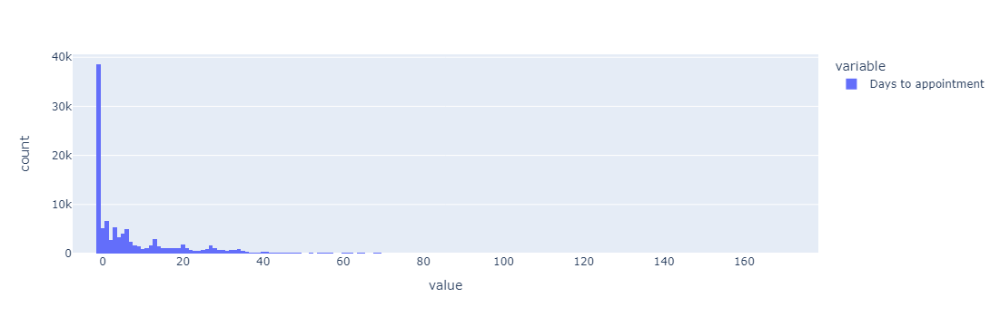

In [35]:
fig = px.histogram(df["Days to appointment"])
fig.show()

In [36]:
df[df["Days to appointment"]== -1]

,Gender,ScheduledDate,AppointmentDate,Age,Neighbourhood,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,Assisted,AppointmentDay,ScheduledDay,Days to appointment
0,F,2016-04-29 18:38:08+00:00,2016-04-29 00:00:00+00:00,62,JARDIM DA PENHA,0,1,0,0,0,0,True,Friday,Friday,-1
1,M,2016-04-29 16:08:27+00:00,2016-04-29 00:00:00+00:00,56,JARDIM DA PENHA,0,0,0,0,0,0,True,Friday,Friday,-1
2,F,2016-04-29 16:19:04+00:00,2016-04-29 00:00:00+00:00,62,MATA DA PRAIA,0,0,0,0,0,0,True,Friday,Friday,-1
3,F,2016-04-29 17:29:31+00:00,2016-04-29 00:00:00+00:00,8,PONTAL DE CAMBURI,0,0,0,0,0,0,True,Friday,Friday,-1
4,F,2016-04-29 16:07:23+00:00,2016-04-29 00:00:00+00:00,56,JARDIM DA PENHA,0,1,1,0,0,0,True,Friday,Friday,-1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
110511,F,2016-06-08 08:50:20+00:00,2016-06-08 00:00:00+00:00,14,MARIA ORTIZ,0,0,0,0,0,0,True,Wednesday,Wednesday,-1
110512,F,2016-06-08 08:20:01+00:00,2016-06-08 00:00:00+00:00,41,MARIA ORTIZ,0,0,0,0,0,0,True,Wednesday,Wednesday,-1
110513,M,2016-06-08 07:52:55+00:00,2016-06-08 00:00:00+00:00,2,ANTÔNIO HONÓRIO,0,0,0,0,0,0,True,Wednesday,Wednesday,-1
110514,F,2016-06-08 08:35:31+00:00,2016-06-08 00:00:00+00:00,58,MARIA ORTIZ,0,0,0,0,0,0,True,Wednesday,Wednesday,-1


The dataset contains a lot of values where the "Days to appointment" value is -1. We can see from the previous dataframe that this is because the Appointment date has only the day of the appoitnment but it has not the hour. And as the Appointment has been scheduled for the same day it has been scheduled then it returns a negative value.

For this values we will replace the -1 value for a 0 value.

In [37]:
# Replace values
df["Days to appointment"].replace(-1, 0, inplace=True)

df[df["Days to appointment"] < -1]

,Gender,ScheduledDate,AppointmentDate,Age,Neighbourhood,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,Assisted,AppointmentDay,ScheduledDay,Days to appointment
27033,M,2016-05-10 10:51:53+00:00,2016-05-09 00:00:00+00:00,38,RESISTÊNCIA,0,0,0,0,1,0,False,Monday,Tuesday,-2
55226,F,2016-05-18 14:50:41+00:00,2016-05-17 00:00:00+00:00,19,SANTO ANTÔNIO,0,0,0,0,1,0,False,Tuesday,Wednesday,-2
64175,F,2016-05-05 13:43:58+00:00,2016-05-04 00:00:00+00:00,22,CONSOLAÇÃO,0,0,0,0,0,0,False,Wednesday,Thursday,-2
71533,F,2016-05-11 13:49:20+00:00,2016-05-05 00:00:00+00:00,81,SANTO ANTÔNIO,0,0,0,0,0,0,False,Thursday,Wednesday,-7
72362,M,2016-05-04 06:50:57+00:00,2016-05-03 00:00:00+00:00,7,TABUAZEIRO,0,0,0,0,0,0,False,Tuesday,Wednesday,-2


For the remaining cases we can see that only 5 records have errors where the dates seem to be inversed. We will consider it has been a typing error and we'll inverse these dates so that everything makes sense.

In [38]:
# Inverse values in columns 1 and 2 (corresponding to ScheduledDate and AppointmentDate) for indexes where the
# Days to appointment value is negative

tmp_values = df[df["Days to appointment"] < -1]["ScheduledDate"].index

for idx in (tmp_values):
    df.iloc[idx,[1,2]] = df.iloc[idx,[2,1]]


In [39]:
# Recalculate the variable Days to appointment 

# Add column with the number of days from the Appointment schedule to the appointment date
df["Days to appointment"] =  pd.to_datetime(df["AppointmentDate"]) - pd.to_datetime(df["ScheduledDate"])

# Change column so that only entire days are considered
df["Days to appointment"] = df["Days to appointment"] // np.timedelta64(1, 'D')

# Replace values
df["Days to appointment"].replace(-1, 0, inplace=True)

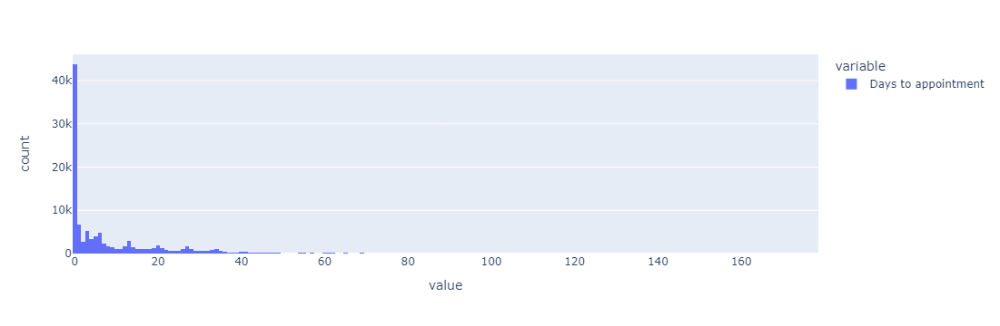

In [40]:
fig = px.histogram(df["Days to appointment"])
fig.show()

In [41]:
# Drop full date columns
df.drop(["AppointmentDate","ScheduledDate","Neighbourhood"], axis = 1, inplace=True)
df.head()

,Gender,Age,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,Assisted,AppointmentDay,ScheduledDay,Days to appointment
0,F,62,0,1,0,0,0,0,True,Friday,Friday,0
1,M,56,0,0,0,0,0,0,True,Friday,Friday,0
2,F,62,0,0,0,0,0,0,True,Friday,Friday,0
3,F,8,0,0,0,0,0,0,True,Friday,Friday,0
4,F,56,0,1,1,0,0,0,True,Friday,Friday,0


# Exploratory Data Analysis (EDA)

Let's start by analysing the "Assisted" variable.

In [42]:
df["Assisted"].value_counts()

Assisted
True     88207
False    22319
Name: count, dtype: int64

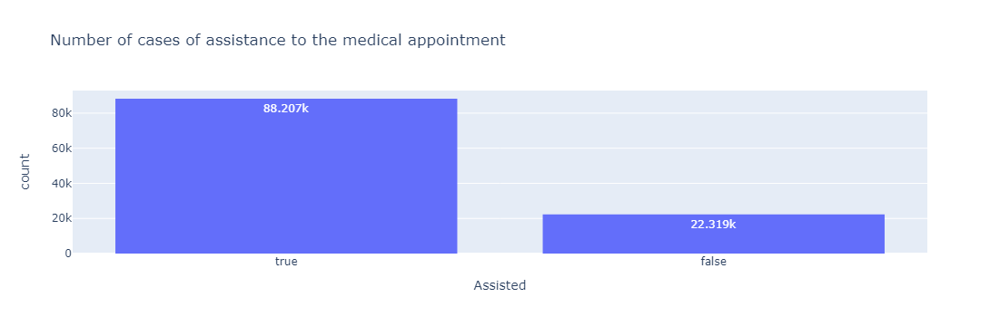

In [43]:
# Plot Assisted distribution of values
fig = px.histogram(df["Assisted"], title="Number of cases of assistance to the medical appointment",
                   labels={
                       "value": "Assisted"
                   },
                    text_auto=True)
fig.update_traces(showlegend=False)
fig.show()

We can see that within our data most cases of pacients have assisted to their appointments. This is important to take in mind once we create our classification models in order to make sure they are not biaised for the True-Assistance class

## Gender analysis

Let's now analyse assitance by gender

In [44]:
df_assitance_by_gender = df.reset_index()[["Gender","Assisted"]]
df_assitance_by_gender.head()

,Gender,Assisted
0,F,True
1,M,True
2,F,True
3,F,True
4,F,True


In [45]:
df_assitance_by_gender = pd.DataFrame(df_assitance_by_gender.groupby(["Gender","Assisted"]).value_counts())
df_assitance_by_gender.reset_index(inplace=True)
df_assitance_by_gender.rename(columns={0:"count"}, inplace=True)
df_assitance_by_gender

,Gender,Assisted,count
0,F,False,14594
1,F,True,57245
2,M,False,7725
3,M,True,30962


In [46]:
df_assitance_by_gender.groupby(["Gender"])["count"].sum().reset_index()

,Gender,count
0,F,71839
1,M,38687


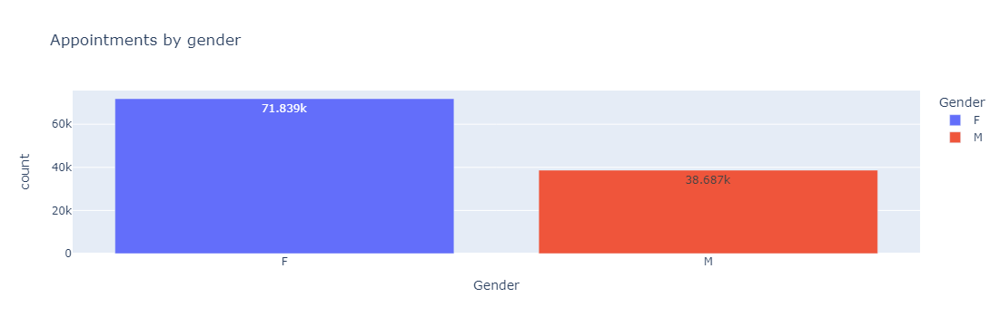

In [47]:
# Plot the number of appointments made by gender

fig = px.bar(df_assitance_by_gender.groupby(["Gender"])["count"].sum().reset_index(),
            title="Appointments by gender",
            x="Gender", y="count", color="Gender",
            text_auto=True
        )
fig.show()

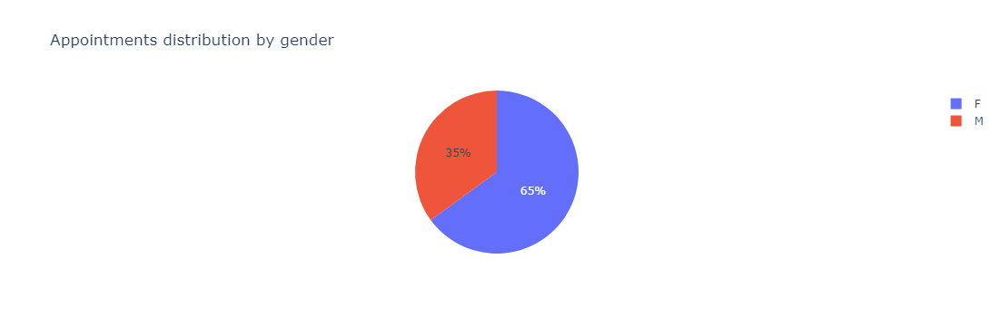

In [48]:
# Plot the percentage of appointments per gender

fig = px.pie(df_assitance_by_gender.groupby(["Gender"])["count"].sum().reset_index(),
             title = "Appointments distribution by gender",
             color_discrete_map = {
                "F" : "red",
                "M" : "blue"
             },
             names="Gender", values="count"
)
fig.show()

As we can see, most of the appointments have been done by women.

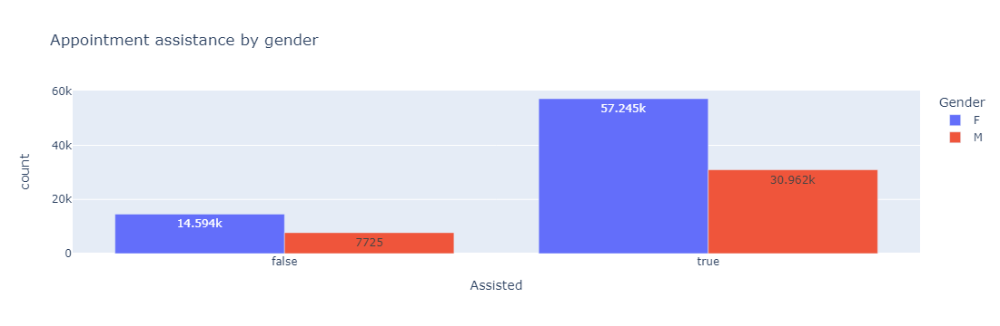

In [49]:
# Plot the appointments assistance by gender 

fig = px.bar(df_assitance_by_gender, barmode="group",
            title ="Appointment assistance by gender",
            color="Gender", y="count", x="Assisted",  text_auto=True)
fig.show()

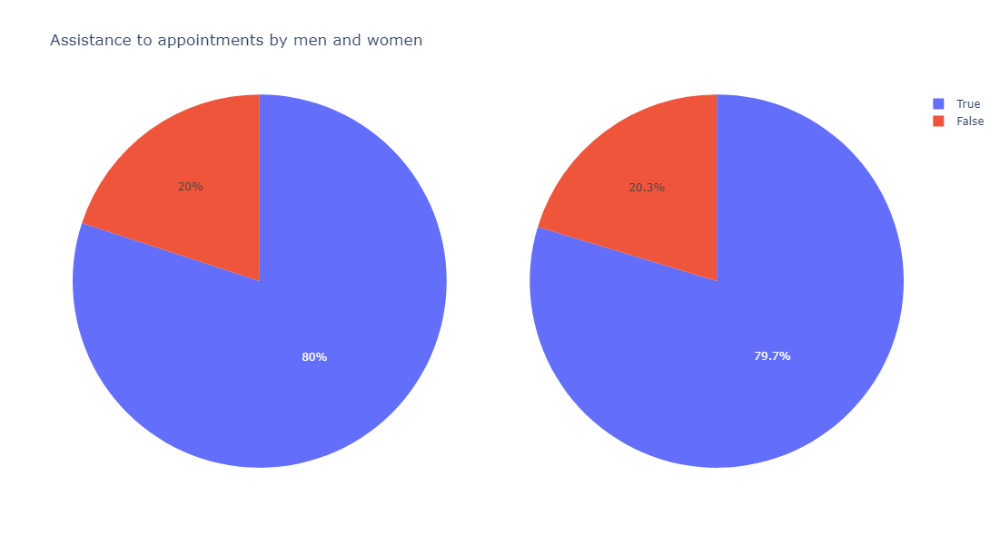

In [50]:
# Plot assistance by men and women in the same figure

fig = make_subplots(rows=1, cols=2, specs=[[{"type": "pie"}, {"type": "pie"}]])


fig.add_trace(go.Pie(
     values=list(df_assitance_by_gender[df_assitance_by_gender["Gender"]=="M"]["count"]),
     labels=["False", "True"],
     domain=dict(x=[0, 0.5]),
     name="Mens Appointments Assistance"), 
     row=1, col=1)

fig.add_trace(go.Pie(
     values=list(df_assitance_by_gender[df_assitance_by_gender["Gender"]=="F"]["count"]),
     labels=["False", "True"],
     domain=dict(x=[0, 0.5]),
     name="Womens Appointments Assistance"), 
     row=1, col=2)

fig.update_layout(title_text="Assistance to appointments by men and women",
                  height=600,
                  showlegend=True
                  )

fig.show()

However the assistance rate between men and women are the same.

## Days to appointment Analysis

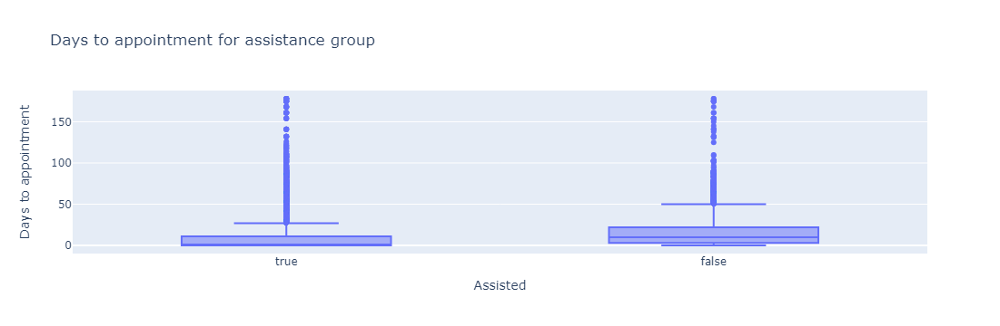

In [51]:
# Plot days to appointment distribution based on Assited groups
fig = px.box(df,
             title="Days to appointment for assistance group",
             y="Days to appointment", x="Assisted"
)
fig.show()

In [52]:
# ANOVA test
import scipy.stats as stats

df_days_to_assistance = df[["Assisted","Days to appointment"]]

anova_results = stats.f_oneway(
    df_days_to_assistance["Days to appointment"][df_days_to_assistance["Assisted"] == True],
    df_days_to_assistance["Days to appointment"][df_days_to_assistance["Assisted"] == False]
)

anova_results

F_onewayResult(statistic=3704.465018801432, pvalue=0.0)

## Age analaysis

Let's now see the impact of the Age variable in the appointments assistance. For this we'll classify our Age variable into groups. For the age groups we'll take : 
* Between 0 and 3 : Babies
* \>=3 and \<12 : Childs
* \>= 12 and \< 18 : Adolescents
* \>= 18 and \< 26 : Young adults
* \>= 26 and \< 45 : Adults
* \>= 45 and \< 65 : Mature adults
* \>= 55 : Elders

In [53]:
df["Age cat"] = pd.cut(df['Age'], [0,3,12,18,26,45,65,116], labels=["Babies","Childs","Adolescents","Young adults","Adults","Mature Adults","Elders"])
age_categories = ["Babies","Childs","Adolescents","Young adults","Adults","Mature Adults","Elders"]

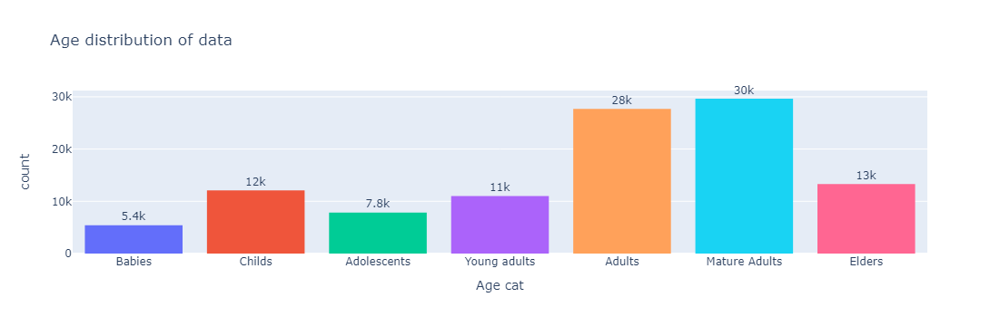

In [54]:
# Plot data distribution based on the age category

fig = px.histogram(df, x=df["Age cat"], color="Age cat",
                    title = "Age distribution of data",
                    text_auto = ".2s",
                    category_orders={ # replaces default order by column name
                        "Age cat": age_categories
                    },
                    labels={
                        "count" : "Number of appointments"
                    }
)

# Set values over the bars
fig.update_traces(textfont_size=12, textangle=0, textposition="outside", cliponaxis=False)

# Hide legend
fig.update_layout(showlegend=False)

fig.show()

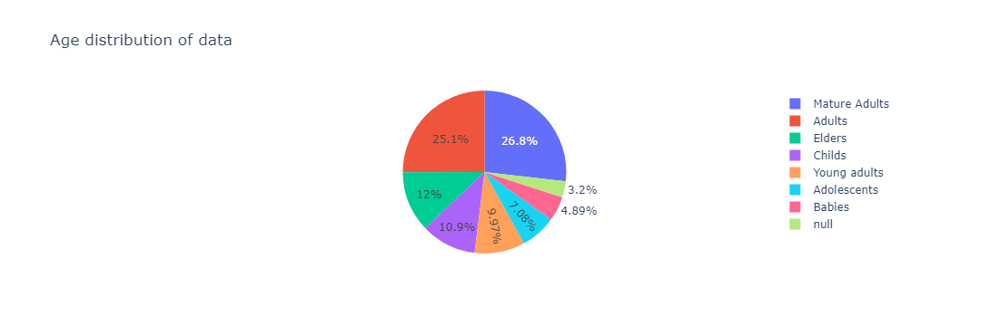

In [55]:
fig = px.pie(df["Age cat"],
             title = "Age distribution of data",
             names="Age cat"
)
fig.show()

Now for each binary variable in our data well compare each category to the "Assisted" variable

In [56]:
# Create Dataframe with Age category and assistance data
df_assistance_by_age = pd.DataFrame(df.groupby(["Age cat", "Assisted"])["Assisted"].count())
df_assistance_by_age.rename(columns={"Assisted":"Assistance"}, inplace = True)
df_assistance_by_age = df_assistance_by_age.reset_index()

# Add percentage of assistance by Age category
df_assistance_by_age = add_assistance_percentage_per_indicator(df_assistance_by_age,"Age cat")
df_assistance_by_age

,Age cat,Assisted,Assistance,Total Age cat appointments,Percentage of appointments
0,Babies,False,944,5404,17.468542
1,Babies,True,4460,5404,82.531458
2,Childs,False,2724,12093,22.525428
3,Childs,True,9369,12093,77.474572
4,Adolescents,False,2040,7830,26.053640
5,Adolescents,True,5790,7830,73.946360
6,Young adults,False,2783,11016,25.263253
7,Young adults,True,8233,11016,74.736747
8,Adults,False,6052,27703,21.846009
9,Adults,True,21651,27703,78.153991


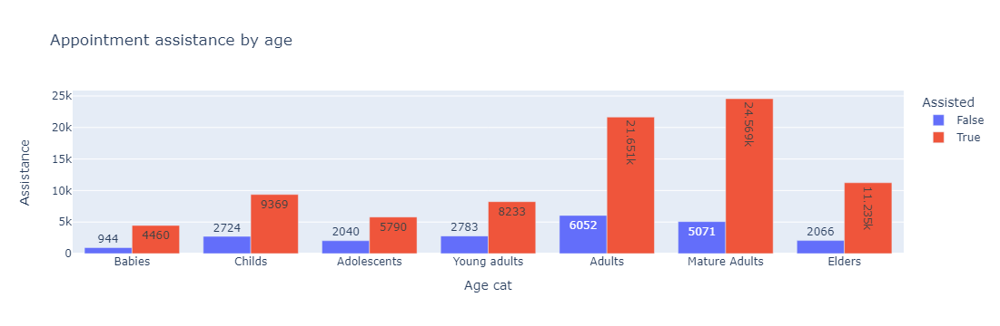

In [57]:
# Plot the appointments assistance by age category

fig = px.bar(df_assistance_by_age, barmode="group",
            title ="Appointment assistance by age",
            color="Assisted", y="Assistance", x="Age cat",  text_auto=True)
fig.show()

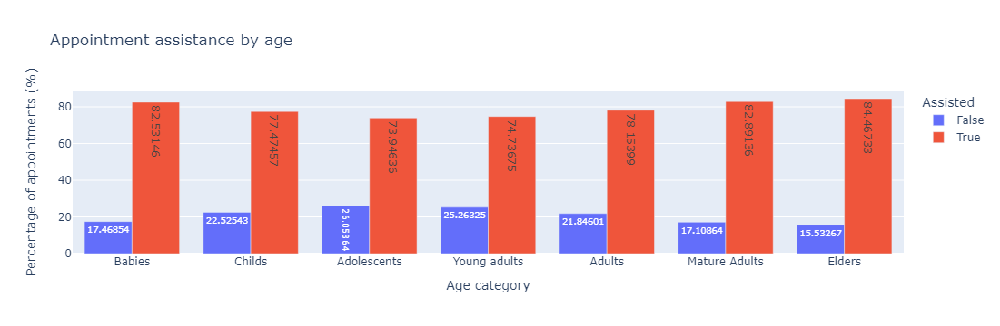

In [58]:
# Plot the appointments assistance by age category

fig = px.bar(df_assistance_by_age, barmode="group",
            title ="Appointment assistance by age",
            color="Assisted", y="Percentage of appointments",
            labels={
                "Percentage of appointments" : "Percentage of appointments (%)",
                "Age cat": "Age category"
            },
             x="Age cat",  text_auto=True)
fig.show()

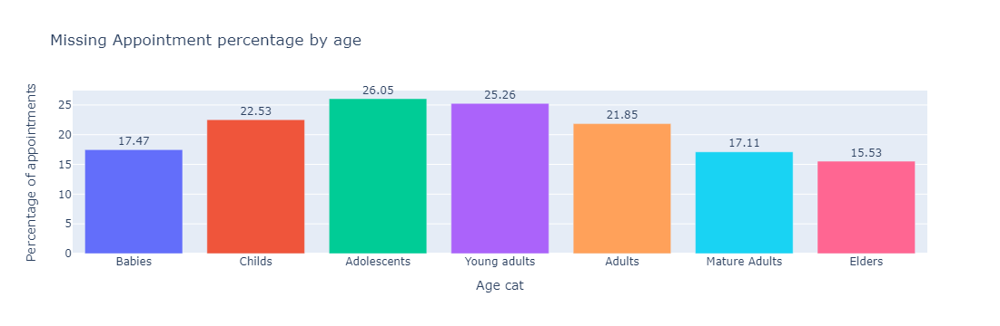

In [59]:
fig = px.bar(df_assistance_by_age[df_assistance_by_age["Assisted"] == False ],
            title ="Missing Appointment percentage by age",
            color="Age cat", y="Percentage of appointments", x="Age cat",  text_auto=".4s",
            category_orders={ # replaces default order by column name
                        "Age cat": age_categories
                    })

# Set values over the bars
fig.update_traces(textfont_size=12, textangle=0, textposition="outside", cliponaxis=False)

# Hide legend
fig.update_layout(showlegend=False)

fig.show()

## Scholarship Analysis

In [60]:
# Dataframe creation
df_assistance_by_scholarship = pd.DataFrame(df.groupby(["Scholarship","Assisted"])["Assisted"].count()).rename(columns={"Assisted":"Assistance"}).reset_index()
df_assistance_by_scholarship["Scholarship"] = df_assistance_by_scholarship["Scholarship"].map({0:"No", 1:"Yes"})

# Add percentage of assistance by Scholarship
df_assistance_by_scholarship = add_assistance_percentage_per_indicator(df_assistance_by_scholarship,"Scholarship")
df_assistance_by_scholarship

,Scholarship,Assisted,Assistance,Total Scholarship appointments,Percentage of appointments
0,No,False,19741,99665,19.807355
1,No,True,79924,99665,80.192645
2,Yes,False,2578,10861,23.736304
3,Yes,True,8283,10861,76.263696


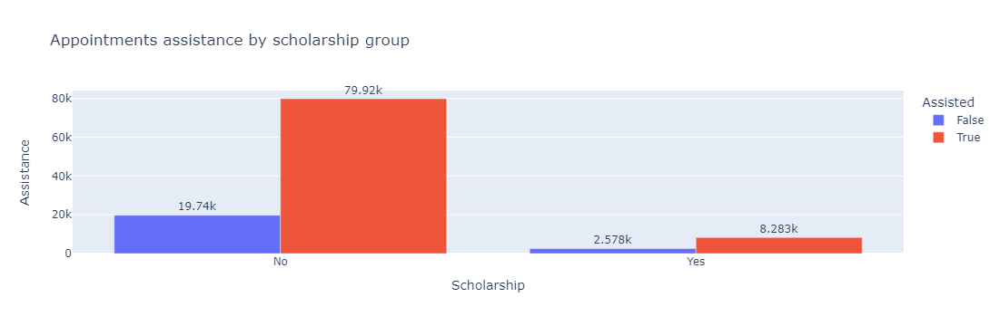

In [61]:
# Plot appointments per scholarship class
fig = px.bar(df_assistance_by_scholarship,
            barmode="group",
            title="Appointments assistance by scholarship group",
            x="Scholarship", y="Assistance", color="Assisted",
            text_auto=".4s"
        )

# Set values over the bars
fig.update_traces(textfont_size=12, textangle=0, textposition="outside", cliponaxis=False)

fig.show()

From this plot we can see that the number of appointments vary importantly based on the scholarship of the Appointment demander. In the left we see that most of the appointments have been scheduled by people with no scholarship defined as true.

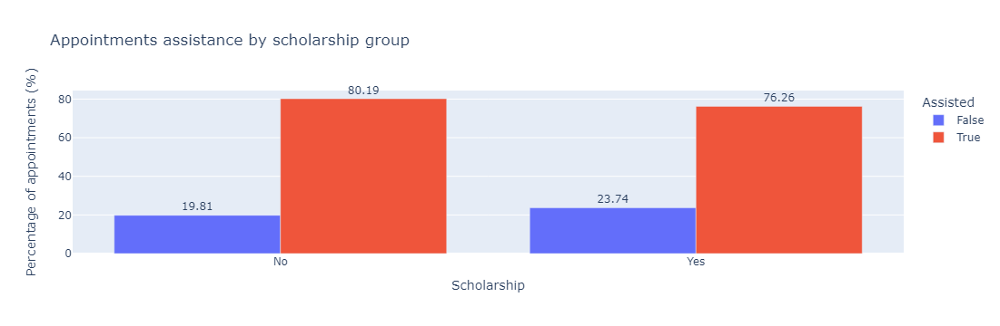

In [62]:
# Plot appointments per scholarship class
fig = px.bar(df_assistance_by_scholarship,
            barmode="group",
            title="Appointments assistance by scholarship group",
            x="Scholarship", y="Percentage of appointments", color="Assisted",
            text_auto=".4s",
            labels = {
                "Percentage of appointments" : "Percentage of appointments (%)"
            }
        )

# Set values over the bars
fig.update_traces(textfont_size=12, textangle=0, textposition="outside", cliponaxis=False)

fig.show()

## SMS reception Analysis

In [63]:
# DataFrame creation with information about the SMS reception and the appointment's assistance
df_assistance_by_sms = pd.DataFrame(df.groupby(["Assisted","SMS_received"])["Assisted"].count()).rename(columns={"Assisted" : "Assistance"}).reset_index()
df_assistance_by_sms["SMS_received"] = df_assistance_by_sms["SMS_received"].map({0:"No", 1:"Yes"})

# Add percentage of assistance by SMS reception
df_assistance_by_sms = add_assistance_percentage_per_indicator(df_assistance_by_sms,"SMS_received")
df_assistance_by_sms

,Assisted,SMS_received,Assistance,Total SMS_received appointments,Percentage of appointments
0,False,No,12535,75044,16.703534
1,False,Yes,9784,35482,27.574545
2,True,No,62509,75044,83.296466
3,True,Yes,25698,35482,72.425455


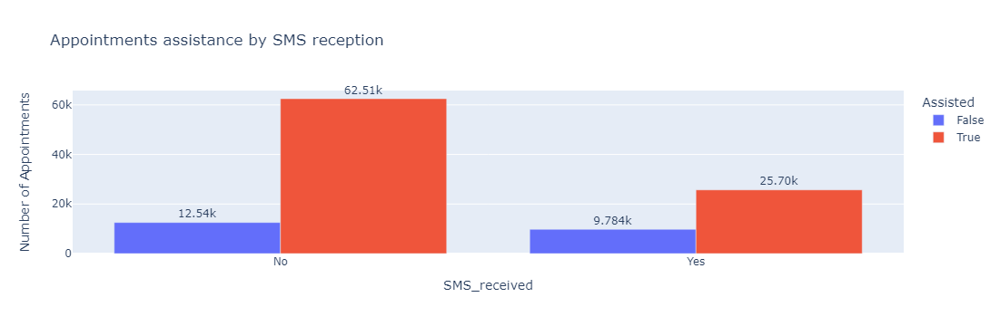

In [64]:
# Plot the number of appointments by SMS reception class
fig = px.bar(df_assistance_by_sms,
            barmode="group",
            title="Appointments assistance by SMS reception",
            x="SMS_received", y="Assistance", color="Assisted",
            text_auto=".4s",
            labels = {
                "Assistance" : "Number of Appointments"
            }
        )

# Set values over the bars
fig.update_traces(textfont_size=12, textangle=0, textposition="outside", cliponaxis=False)

fig.show()

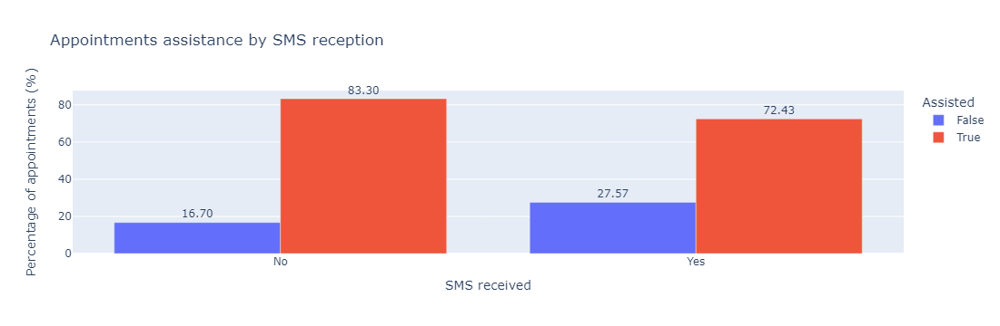

In [65]:
# Plot the number of appointments by SMS reception class
fig = px.bar(df_assistance_by_sms,
            barmode="group",
            title="Appointments assistance by SMS reception",
            x="SMS_received", y="Percentage of appointments", color="Assisted",
            text_auto=".4s",
            labels = {
                "Percentage of appointments" : "Percentage of appointments (%)",
                "SMS_received": "SMS received"
            }
        )

# Set values over the bars
fig.update_traces(textfont_size=12, textangle=0, textposition="outside", cliponaxis=False)

fig.show()

In the case of the SMS reception variable we can see that the percentage of missing appointments between groups is more important than in the previous variables groups. However is interesting to note that the Missing appointment rate of persons who have received a confirmation SMS is higher than that of persons who did not received an SMS. 

Let's try to analyse if the SMS reception has an impact in the assistance based in the days on impact variable.
(For example : Does a person having an appointment far in time will be more likely to come if an SMS was sent ? Or a person with an appointment far in time we'll miss the appointment because no SMS was sent to remind ?)

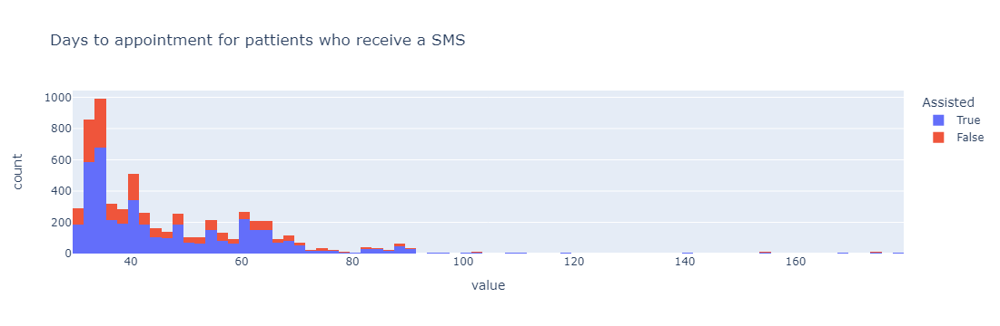

In [66]:
# Plot SMS reception variable with assistance and days to appointment for appointments farther than 30 days

fig = px.histogram(df[(df["SMS_received"]== True) & (df["Days to appointment"] > 30)][["Days to appointment","Assisted"]],
    title = "Days to appointment for pattients who receive a SMS",
    color ="Assisted"
)
fig.show()

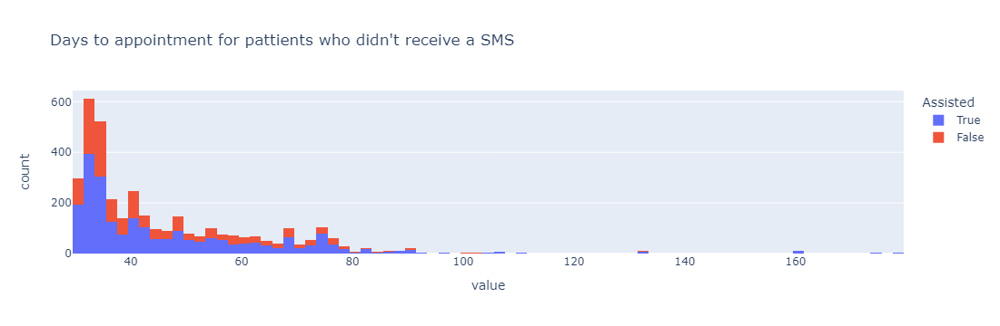

In [67]:
# Plot SMS reception variable with assistance and days to appointment for appointments farther than 30 days

fig = px.histogram(df[(df["SMS_received"]== False) & (df["Days to appointment"] > 30)][["Days to appointment","Assisted"]],
    title = "Days to appointment for pattients who didn't receive a SMS",
    color ="Assisted"
)
fig.show()

From the graphs above we can not conclude that the SMS has an impact in the assistance based on the days to appointment variable.

## Alcoholism Analysis

In [68]:
# DataFrame creation with information about the Alcoholism variable and the appointment's assistance
df_assistance_by_alcoholism = pd.DataFrame(df.groupby(["Assisted","Alcoholism"])["Assisted"].count()).rename(columns={"Assisted" : "Assistance"}).reset_index()
df_assistance_by_alcoholism["Alcoholism"] = df_assistance_by_alcoholism["Alcoholism"].map({0:"No", 1:"Yes"})

# Add percentage of assistance by Alcoholism class
df_assistance_by_alcoholism = add_assistance_percentage_per_indicator(df_assistance_by_alcoholism,"Alcoholism")
df_assistance_by_alcoholism

,Assisted,Alcoholism,Assistance,Total Alcoholism appointments,Percentage of appointments
0,False,No,21642,107166,20.194838
1,False,Yes,677,3360,20.148810
2,True,No,85524,107166,79.805162
3,True,Yes,2683,3360,79.851190


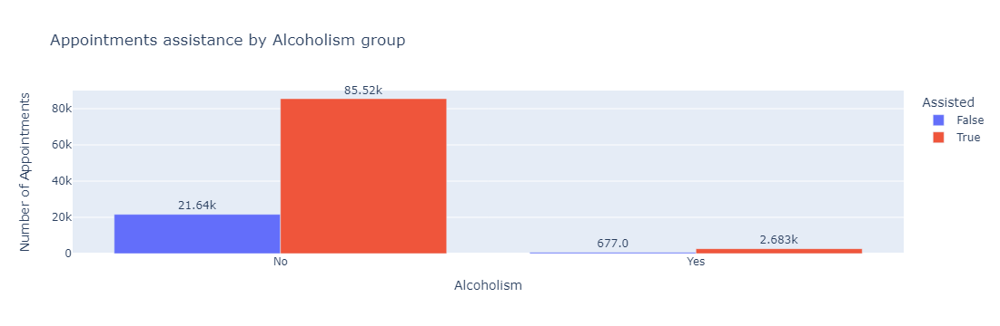

In [69]:
# Plot the number of appointments by Alcoholism group
fig = px.bar(df_assistance_by_alcoholism,
            barmode="group",
            title="Appointments assistance by Alcoholism group",
            x="Alcoholism", y="Assistance", color="Assisted",
            text_auto=".4s",
            labels = {
                "Assistance" : "Number of Appointments"
            }
        )

# Set values over the bars
fig.update_traces(textfont_size=12, textangle=0, textposition="outside", cliponaxis=False)

fig.show()

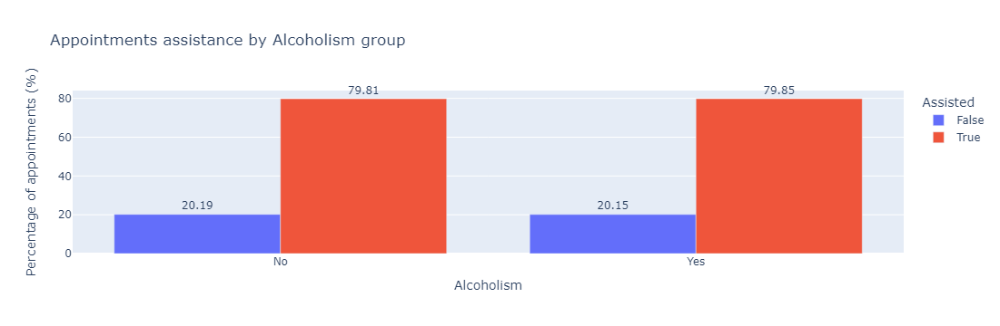

In [70]:
# Plot the number of appointments by Alcoholism group
fig = px.bar(df_assistance_by_alcoholism,
            barmode="group",
            title="Appointments assistance by Alcoholism group",
            x="Alcoholism", y="Percentage of appointments", color="Assisted",
            text_auto=".4s",
            labels = {
                "Percentage of appointments" : "Percentage of appointments (%)"
            }
        )

# Set values over the bars
fig.update_traces(textfont_size=12, textangle=0, textposition="outside", cliponaxis=False)

fig.show()

## Diabetes Analysis

In [71]:
# DataFrame creation with information about the Diabetes variable and the appointment's assistance
df_assistance_by_diabetes = pd.DataFrame(df.groupby(["Assisted","Diabetes"])["Assisted"].count()).rename(columns={"Assisted" : "Assistance"}).reset_index()
df_assistance_by_diabetes["Alcoholism"] = df_assistance_by_diabetes["Diabetes"].map({0:"No", 1:"Yes"})

# Add percentage of assistance by Diabetes class
df_assistance_by_diabetes = add_assistance_percentage_per_indicator(df_assistance_by_diabetes,"Diabetes")
df_assistance_by_diabetes

,Assisted,Diabetes,Assistance,Alcoholism,Total Diabetes appointments,Percentage of appointments
0,False,0,20889,No,102583,20.363023
1,False,1,1430,Yes,7943,18.003273
2,True,0,81694,No,102583,79.636977
3,True,1,6513,Yes,7943,81.996727


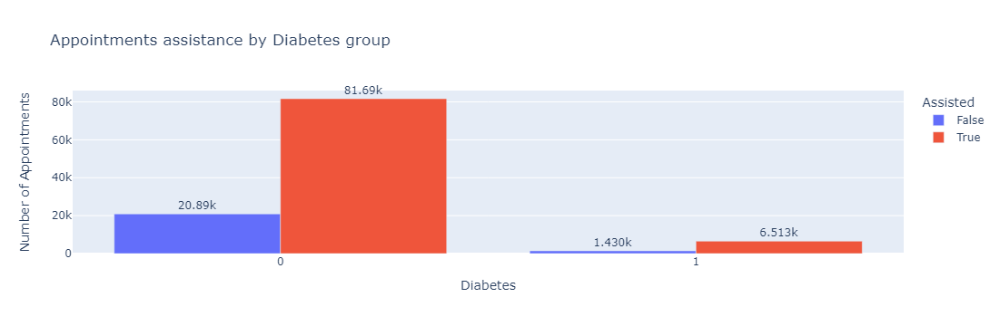

In [72]:
# Plot the number of appointments by Diabetes group
fig = px.bar(df_assistance_by_diabetes,
            barmode="group",
            title="Appointments assistance by Diabetes group",
            x="Diabetes", y="Assistance", color="Assisted",
            text_auto=".4s",
            labels = {
                "Assistance" : "Number of Appointments"
            }
        )

# Set values over the bars
fig.update_traces(textfont_size=12, textangle=0, textposition="outside", cliponaxis=False)

fig.show()

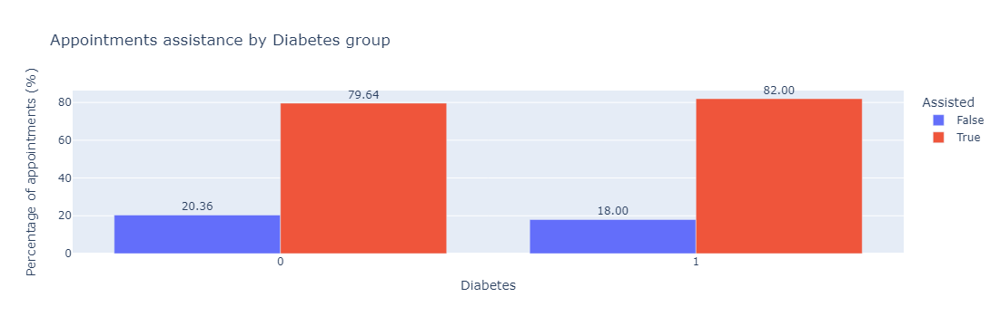

In [73]:
# Plot the number of appointments by Diabetes group
fig = px.bar(df_assistance_by_diabetes,
            barmode="group",
            title="Appointments assistance by Diabetes group",
            x="Diabetes", y="Percentage of appointments", color="Assisted",
            text_auto=".4s",
            labels = {
                "Percentage of appointments" : "Percentage of appointments (%)"
            }
        )

# Set values over the bars
fig.update_traces(textfont_size=12, textangle=0, textposition="outside", cliponaxis=False)

fig.show()

## Hipertension Analysis

In [74]:
# DataFrame creation with information about the Hipertension variable and the appointment's assistance
df_assistance_by_hipertension = pd.DataFrame(df.groupby(["Assisted","Hipertension"])["Assisted"].count()).rename(columns={"Assisted" : "Assistance"}).reset_index()
df_assistance_by_hipertension["Hipertension"] = df_assistance_by_hipertension["Hipertension"].map({0:"No", 1:"Yes"})

# Add percentage of assistance by Alcoholism class
df_assistance_by_hipertension = add_assistance_percentage_per_indicator(df_assistance_by_hipertension,"Hipertension")
df_assistance_by_hipertension

,Assisted,Hipertension,Assistance,Total Hipertension appointments,Percentage of appointments
0,False,No,18547,88725,20.903917
1,False,Yes,3772,21801,17.301959
2,True,No,70178,88725,79.096083
3,True,Yes,18029,21801,82.698041


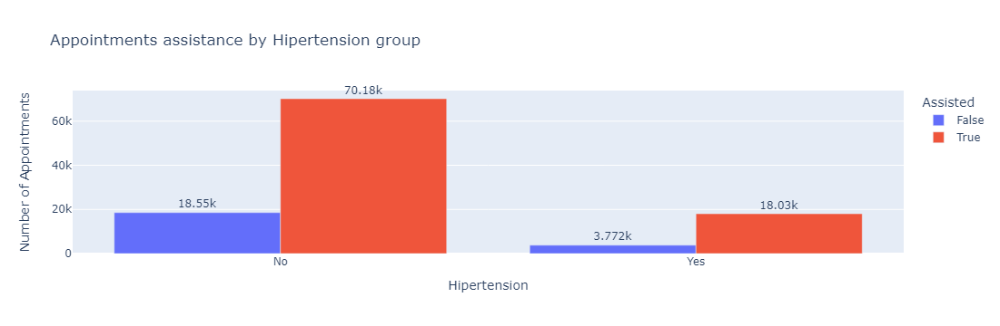

In [75]:
# Plot the number of appointments by Hipertension group
fig = px.bar(df_assistance_by_hipertension,
            barmode="group",
            title="Appointments assistance by Hipertension group",
            x="Hipertension", y="Assistance", color="Assisted",
            text_auto=".4s",
            labels = {
                "Assistance" : "Number of Appointments"
            }
        )

# Set values over the bars
fig.update_traces(textfont_size=12, textangle=0, textposition="outside", cliponaxis=False)

fig.show()

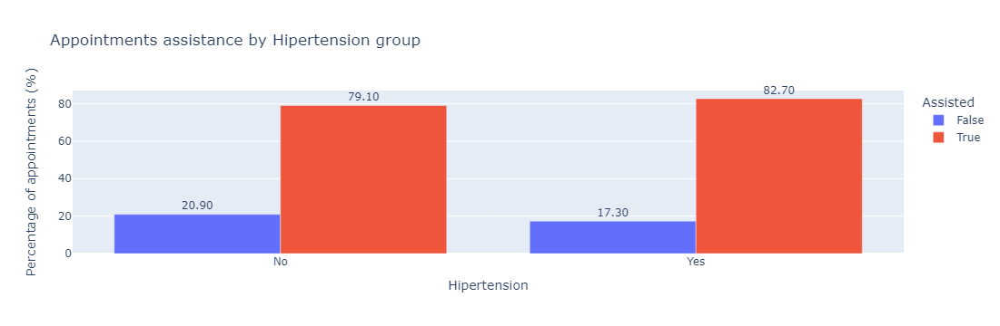

In [76]:
# Plot the number of appointments by Hipertension group
fig = px.bar(df_assistance_by_hipertension,
            barmode="group",
            title="Appointments assistance by Hipertension group",
            x="Hipertension", y="Percentage of appointments", color="Assisted",
            text_auto=".4s",
            labels = {
                "Percentage of appointments" : "Percentage of appointments (%)"
            }
        )

# Set values over the bars
fig.update_traces(textfont_size=12, textangle=0, textposition="outside", cliponaxis=False)

fig.show()

## Scheduled day and Appointment day Analysis

In [77]:
days = ["Monday", "Tuesday", "Wednesday","Thursday","Friday","Saturday","Sunday"]

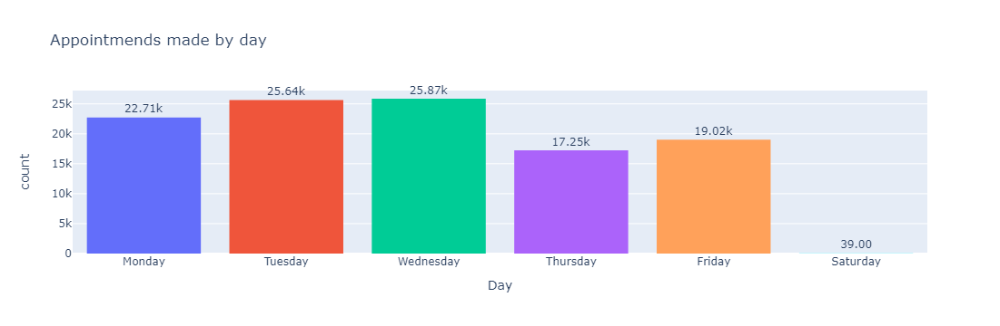

In [78]:
# Plot number of appointments by the day they were made

fig = px.histogram(df["AppointmentDay"], 
                title = "Appointmends made by day",
                labels = {
                    "value" : "Day",
                    "count" : "Appointments"
                },
                category_orders={ # replaces default order by column name
                "value": days
            }, color="value",
            text_auto=".4s")


# Set values over the bars
fig.update_traces(textfont_size=12, textangle=0, textposition="outside", cliponaxis=False)

# Hide legend
fig.update_layout(showlegend=False)

fig.show()

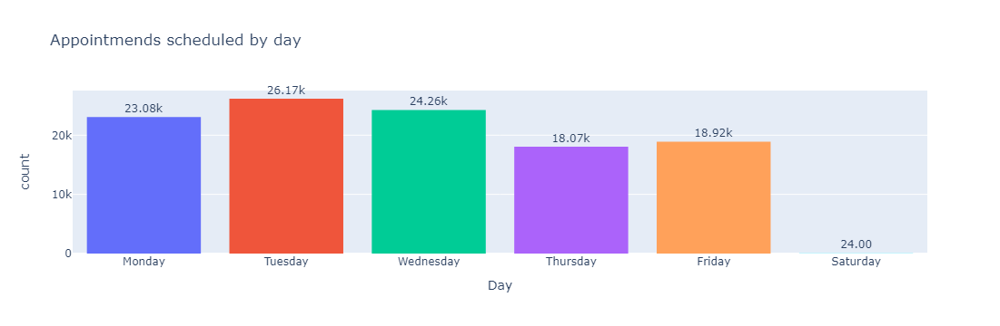

In [79]:
# Plot number of appointments by the day they were scheduled

fig = px.histogram(df["ScheduledDay"], 
                title = "Appointmends scheduled by day",
                labels = {
                    "value" : "Day",
                    "count" : "Appointments"
                },
                category_orders={ # replaces default order by column name
                "value": days
            }, color="value",
            text_auto=".4s")


# Set values over the bars
fig.update_traces(textfont_size=12, textangle=0, textposition="outside", cliponaxis=False)

# Hide legend
fig.update_layout(showlegend=False)

fig.show()

In [80]:
# Create a Dataframe with appointmend day assistance information
df_assistance_by_appointmentday = pd.DataFrame(df.groupby(["AppointmentDay","Assisted"])["Assisted"].count()).rename(columns={"Assisted":"Assistance"}).reset_index()
df_assistance_by_appointmentday

,AppointmentDay,Assisted,Assistance
0,Friday,False,4037
1,Friday,True,14982
2,Monday,False,4690
3,Monday,True,18024
4,Saturday,False,9
5,Saturday,True,30
6,Thursday,False,3338
7,Thursday,True,13909
8,Tuesday,False,5152
9,Tuesday,True,20488


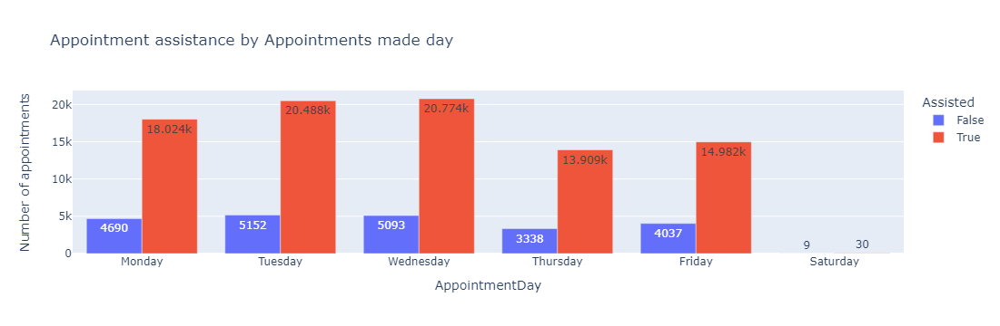

In [81]:
# Plot the appointments assistance by appointment's made day

fig = px.bar(df_assistance_by_appointmentday, barmode="group",
            title ="Appointment assistance by Appointments made day",
            color="Assisted", y="Assistance", x="AppointmentDay",  text_auto=True,
            category_orders={
                "AppointmentDay": days
            },
            labels = {
                "Assistance" : "Number of appointments"
            }
)
fig.show()

In [82]:
# Add percentage of assistance by Appointments made day
df_assistance_by_appointmentday = add_assistance_percentage_per_indicator(df_assistance_by_appointmentday,"AppointmentDay")
df_assistance_by_appointmentday

,AppointmentDay,Assisted,Assistance,Total AppointmentDay appointments,Percentage of appointments
0,Friday,False,4037,19019,21.226142
1,Friday,True,14982,19019,78.773858
2,Monday,False,4690,22714,20.648058
3,Monday,True,18024,22714,79.351942
4,Saturday,False,9,39,23.076923
5,Saturday,True,30,39,76.923077
6,Thursday,False,3338,17247,19.354091
7,Thursday,True,13909,17247,80.645909
8,Tuesday,False,5152,25640,20.093604
9,Tuesday,True,20488,25640,79.906396


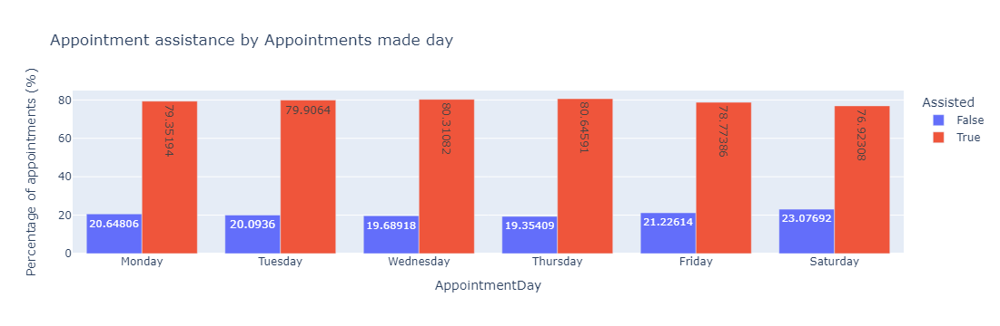

In [83]:
# Plot the appointments assistance by appointment's made day

fig = px.bar(df_assistance_by_appointmentday, barmode="group",
            title ="Appointment assistance by Appointments made day",
            color="Assisted", y="Percentage of appointments", x="AppointmentDay",  text_auto=True,
            category_orders={
                "AppointmentDay": days
            },
            labels = {
                "Percentage of appointments" : "Percentage of appointments (%)"
            }
)
fig.show()

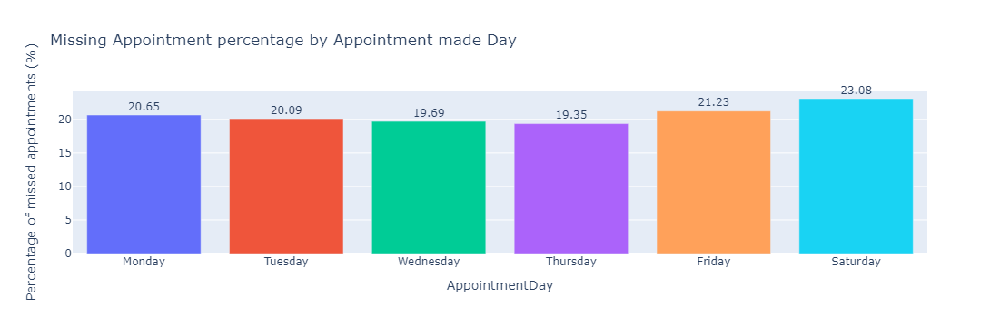

In [84]:
# Plot missed assistance per Appointment made day
plot_missing_assistance_percentage_per_indicator(df_assistance_by_appointmentday, "AppointmentDay",
                                                 "Missing Appointment percentage by Appointment made Day")

In [85]:
# Create a Dataframe with scheduled day assistance information
df_assistance_by_scheduledday = pd.DataFrame(df.groupby(["ScheduledDay","Assisted"])["Assisted"].count()).rename(columns={"Assisted":"Assistance"}).reset_index()
df_assistance_by_scheduledday

,ScheduledDay,Assisted,Assistance
0,Friday,False,3887
1,Friday,True,15028
2,Monday,False,4561
3,Monday,True,18523
4,Saturday,False,1
5,Saturday,True,23
6,Thursday,False,3700
7,Thursday,True,14373
8,Tuesday,False,5291
9,Tuesday,True,20877


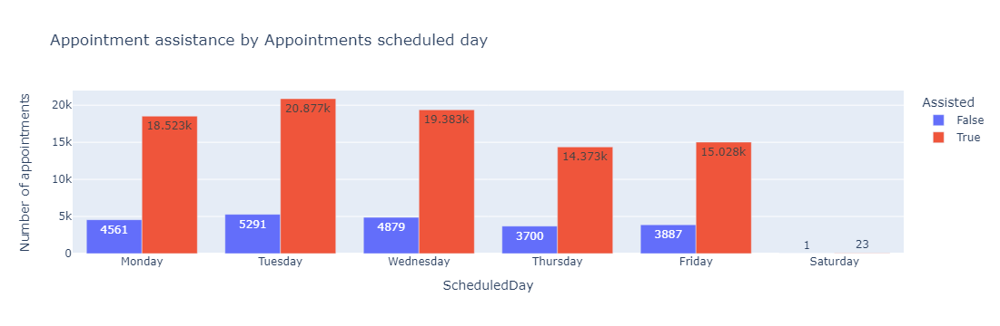

In [86]:
# Plot the appointments assistance by appointment's scheduled day

fig = px.bar(df_assistance_by_scheduledday, barmode="group",
            title ="Appointment assistance by Appointments scheduled day",
            color="Assisted", y="Assistance", x="ScheduledDay",  text_auto=True,
            category_orders={
                "ScheduledDay": days
            },
            labels={
                "Assistance":"Number of appointments"
            }
)
fig.show()

In [87]:
# Add percentage of assistance by Appointments scheduled day
df_assistance_by_scheduledday = add_assistance_percentage_per_indicator(df_assistance_by_scheduledday,"ScheduledDay")
df_assistance_by_scheduledday

,ScheduledDay,Assisted,Assistance,Total ScheduledDay appointments,Percentage of appointments
0,Friday,False,3887,18915,20.549828
1,Friday,True,15028,18915,79.450172
2,Monday,False,4561,23084,19.758274
3,Monday,True,18523,23084,80.241726
4,Saturday,False,1,24,4.166667
5,Saturday,True,23,24,95.833333
6,Thursday,False,3700,18073,20.472528
7,Thursday,True,14373,18073,79.527472
8,Tuesday,False,5291,26168,20.219352
9,Tuesday,True,20877,26168,79.780648


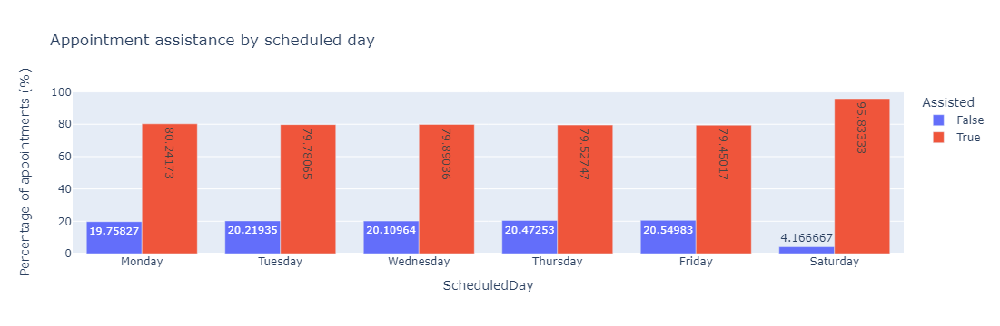

In [88]:
# Plot the appointments assistance by appointment's scheduled day

fig = px.bar(df_assistance_by_scheduledday, barmode="group",
            title ="Appointment assistance by scheduled day",
            color="Assisted", y="Percentage of appointments", x="ScheduledDay",  text_auto=True,
            category_orders={
                "ScheduledDay": days
            },
            labels={
                "Percentage of appointments":"Percentage of appointments (%)"
            }
)
fig.show()

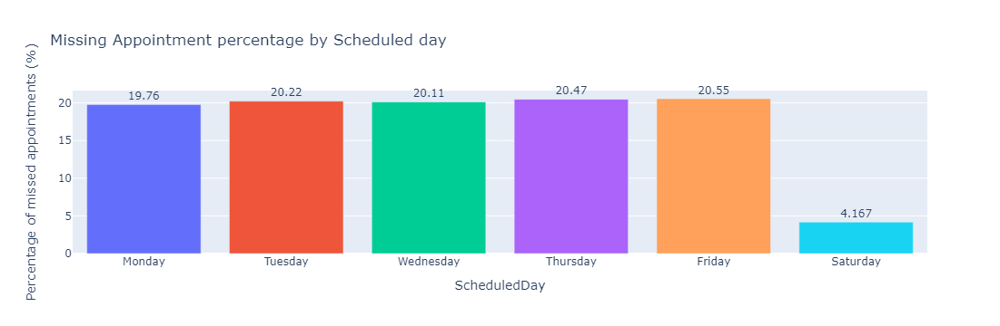

In [89]:
# Plot missed assistance per Appointment's scheduled day
plot_missing_assistance_percentage_per_indicator(df_assistance_by_scheduledday, "ScheduledDay",
                                                 "Missing Appointment percentage by Scheduled day")

# Data pre-processing

In order to create prediction models let's start by preparing our data. For this we'll create a set of data for training the models and a set for testing.

In [90]:
from sklearn.model_selection import train_test_split

In [91]:
data = df.copy()
data.drop(["Age"], axis=1, inplace=True)
data.head()

,Gender,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,Assisted,AppointmentDay,ScheduledDay,Days to appointment,Age cat
0,F,0,1,0,0,0,0,True,Friday,Friday,0,Mature Adults
1,M,0,0,0,0,0,0,True,Friday,Friday,0,Mature Adults
2,F,0,0,0,0,0,0,True,Friday,Friday,0,Mature Adults
3,F,0,0,0,0,0,0,True,Friday,Friday,0,Childs
4,F,0,1,1,0,0,0,True,Friday,Friday,0,Mature Adults


In [92]:
# Create dummy variables for categorical variables
data = pd.get_dummies(data)
data.head()

,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,Assisted,Days to appointment,Gender_F,Gender_M,...,ScheduledDay_Thursday,ScheduledDay_Tuesday,ScheduledDay_Wednesday,Age cat_Babies,Age cat_Childs,Age cat_Adolescents,Age cat_Young adults,Age cat_Adults,Age cat_Mature Adults,Age cat_Elders
0,0,1,0,0,0,0,True,0,True,False,...,False,False,False,False,False,False,False,False,True,False
1,0,0,0,0,0,0,True,0,False,True,...,False,False,False,False,False,False,False,False,True,False
2,0,0,0,0,0,0,True,0,True,False,...,False,False,False,False,False,False,False,False,True,False
3,0,0,0,0,0,0,True,0,True,False,...,False,False,False,False,True,False,False,False,False,False
4,0,1,1,0,0,0,True,0,True,False,...,False,False,False,False,False,False,False,False,True,False


In [93]:
# Create train and test splits
Y = data["Assisted"]
X = data.drop(["Assisted"], axis=1)
x_train, x_test, y_train, y_test = train_test_split(X,Y, test_size=0.3, random_state = 0)
print("Train dataset size ",x_train.shape[0])
print("Test dataset size ",x_test.shape[0])

Train dataset size  77368
Test dataset size  33158


# Logistic Regression Model

In [94]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix

In [95]:
# Simple model test 
lr = LogisticRegression(C= 0.01, solver="newton-cg", class_weight = {0:0.65, 1:0.35})
lr.fit(x_train, y_train)

LogisticRegression(C=0.01, class_weight={0: 0.65, 1: 0.35}, solver='newton-cg')

In [96]:
# Predictions of the simple model
y_hat = lr.predict(x_test)

In [98]:
# Logistic regression score
lr_score = lr.score(x_test, y_test)
lr_score

0.7768864225827854

In [99]:
# Confusion Matrix
cnf_matrix = confusion_matrix(y_test, y_hat, labels=[1,0])
cnf_matrix

array([[24992,  1573],
       [ 5825,   768]], dtype=int64)

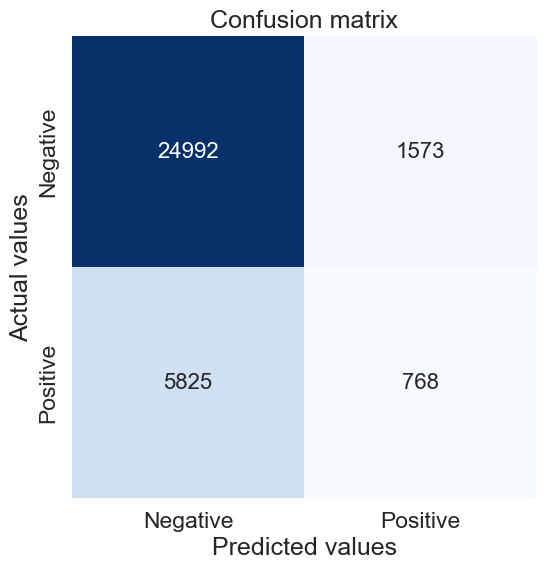

In [100]:
# Plot confusion matrix
plot_confusion_matrix(cnf_matrix, title="Confusion matrix")

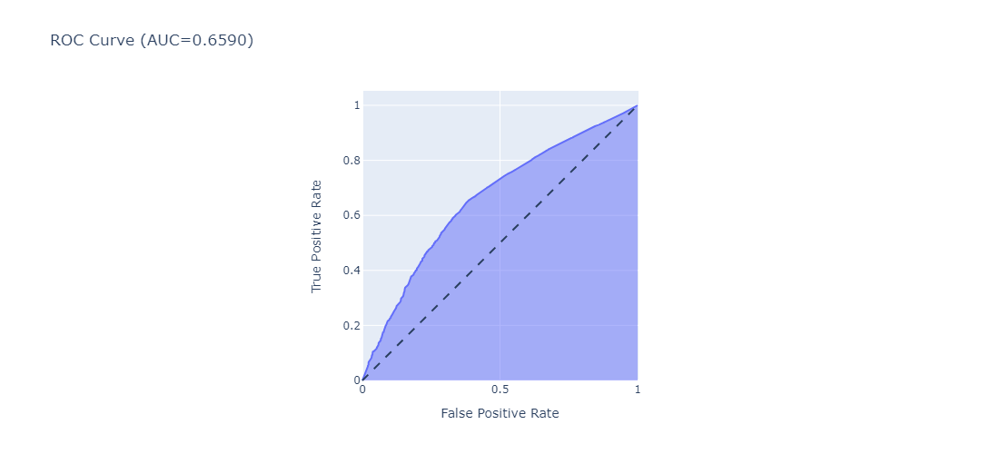

In [101]:
# Plot ROC Curve
plot_roc_curve(x_test, y_test, lr)

# Decision tree classifier

In [103]:
!pip install graphviz

   ---------------------------------------- 0.0/47.1 kB ? eta -:--:--
   -------- ------------------------------- 10.2/47.1 kB ? eta -:--:--
   ----------------- ---------------------- 20.5/47.1 kB 682.7 kB/s eta 0:00:01
   ----------------- ---------------------- 20.5/47.1 kB 682.7 kB/s eta 0:00:01
   ----------------- ---------------------- 20.5/47.1 kB 682.7 kB/s eta 0:00:01
   ---------------------------------------- 47.1/47.1 kB 236.4 kB/s eta 0:00:00


In [104]:
from sklearn.tree import DecisionTreeClassifier
from sklearn import metrics
import graphviz

In [105]:
# Create Decision Tree classifer object
dt = DecisionTreeClassifier(class_weight="balanced")

# Train Decision Tree Classifer
dt = dt.fit(x_train,y_train)

#Predict the response for test dataset
y_hat = dt.predict(x_test)

In [106]:
# Model Accuracy
print("Accuracy:",metrics.accuracy_score(y_test, y_hat))

Accuracy: 0.6428916098679052


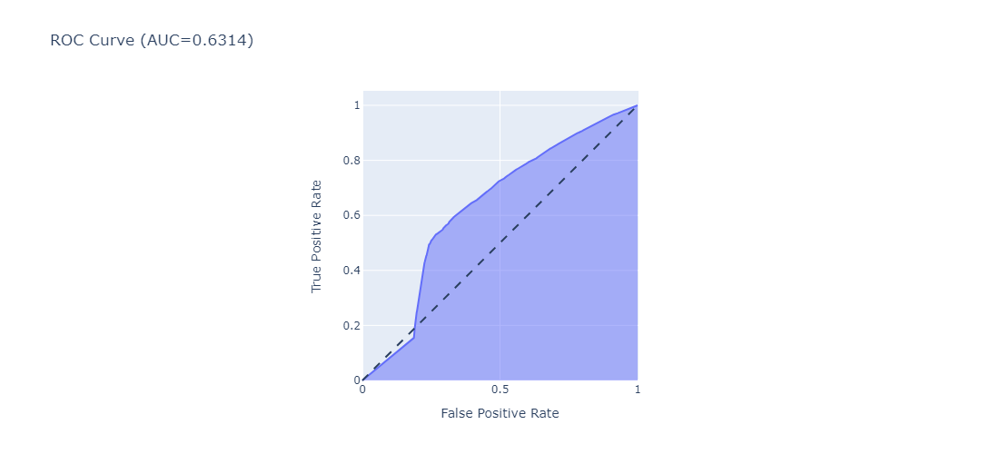

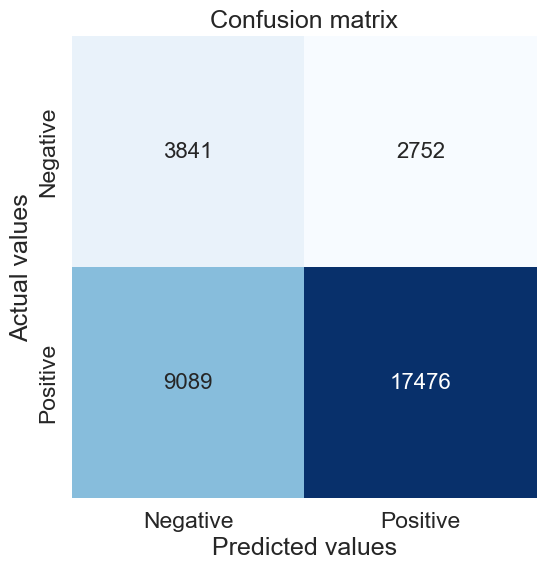

In [108]:
# Confusion Matrix
cnf_matrix = confusion_matrix(y_test, y_hat, labels=[0,1])

# Plot confusion matrix
plot_confusion_matrix(cnf_matrix, title="Confusion matrix")

# Plot ROC Curve
plot_roc_curve(x_test, y_test, dt)

# Conclusions

Unfortunately we cannot conclude from the studied data that some of the variables may predict if a pattien will show or not to an appointment. 

However we saw in the EDA section as well as whithin the Decision tree model, some interesting facts : 
- Contrary to expectations the reception of an SMS to confirm the appointment seems to have a negative impact in the appointment's assistance
- The wating time from the appointment's schedule day and the appointment day seems to have an impact in the assistance. We saw that the farthest the appointment, the more probable is that the pattient will not show to the appointment. This seems logic as some patiens may have lost control over events in far-off dates. We also saw that the reminder SMS did not have an impact in the appointments with far-off appoitnment's dates.